# AASD4015 - Advanced Mathematical Concepts for Deep Learning

## Project: Generating Music with Deep Learning

#### Github Pages Link: https://mahmudnahid.github.io/dl2-project2/


### Team Members:
- Khandaker Nahid Mahmud (101427435)
- Siddhant Gite (101359755)

# Problem Statement: 

Generating long pieces of music is a challenging problem, as music contains structure at multiple timescales, from milisecond timings to motifs to phrases to repetition of entire sections. In this project we trained 2 models on the Bach chorales dataset to generate Bach-like music. This is an excercise problem from chapter 15 of the book [Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 2nd Edition](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/) by Aurélien Géron. The exercise is as follow:

Download the [Bach chorales](https://github.com/ageron/data/tree/main/jsb_chorales) dataset and unzip it. It is composed of 382 chorales composed by Johann Sebastian Bach. Each chorale is 100 to 640 time steps long, and each time step contains 4 integers, where each integer corresponds to a note's index on a piano (except for the value 0, which means that no note is played). Train a model—recurrent, convolutional, or both—that can predict the next time step (four notes), given a sequence of time steps from a chorale. Then use this model to generate Bach-like music, one note at a time: you can do this by giving the model the start of a chorale and asking it to predict the next time step, then appending these time steps to the input sequence and asking the model for the next note, and so on. 


But along with the CNN model as suggested, we implemented two models for generating music:

1. CNN & LSTM based Model
2. Transformer based Model


# Introduction

A musical piece often consists of recurring elements at various levels, from motifs to phrases to sections such as verse-chorus. To generate a coherent piece, a model needs to reference elements that came before, sometimes in the distant past, repeating, varying, and further developing them to create contrast and surprise. But before we delve into the technical implementation  let us understand the building blocks of music:

<img src="https://raw.githubusercontent.com/mahmudnahid/dl2-project2/main/images/piano.png" width="500" />


Labels of the notes are (in sharp, #, notation):

```
  C#   D#        F#   G#   A#
C    D    E    F    G    A    B ...
```

Labels of the notes are (in flat, $\flat$, notation):

```
  Db   Eb        Gb   Ab   Bb
C    D    E    F    G    A    B ...
```


The A in the 4th octave is typically tuned at 440 Hz

* A half step is the smallest increment you can make
* After twelve half-steps you're back to the same note, but it sounds exactly twice as high
* In standard piano tuning, the frequency is multiplied by ${}^{12}\sqrt{2} \approx 1.059$

Frequency of note is implemented as:

$$f = f_{\mathrm{A4}}\bigg( {}^{12}\sqrt{2} \bigg)^ N $$

where $N$ is the number of steps needed (can be negative) to move from A4 to the desired note.

**Scale:**
A scale is a selection of notes that fit well together.

**Chords:**
A chord is any harmonic set of pitches/frequencies consisting of multiple notes that are heard as if sounding simultaneously.

**Arpeggio:**
An arpeggio is a type of broken chord in which the notes that compose a chord are individually sounded in a progressive rising or descending order.



#### Reference: 
- https://www.youtube.com/watch?v=hXrpV2ffJRU&ab_channel=JustinGuitar
- https://github.com/marcelraas/music-generator/blob/master/presentation/2-music-generation.ipynb


Now that we know the building blocks of music, let us understand how we can generate music with deep learning. We take a language-modeling approach to training generative models for symbolic music. Hence we represent music as a sequence of discrete tokens, with the vocabulary determined by the dataset.

The JSB Chorale dataset consists of four-part scored choral music, which can be represented as a matrix where rows correspond to chords and columns to time discretized notes. The matrix’s entries are integers that denote which pitch is being played. Notes range from 36 (C1 = C on octave 1) to 81 (A5 = A on octave 5), plus 0 for silence:

<img src="https://raw.githubusercontent.com/mahmudnahid/dl2-project2/main/images/chorale.JPG" width="250" />


This is very similar to time-series data or word sequence data  in NLP. So we took a sequence to sequence modeling approach for generating the output note sequences. Each chorale will be a long sequence of notes (rather than chords), and we can just train a model that can predict the next note given all the previous notes. We will feed a window to the neural net, and it tries to predict that same window shifted one time step into the future.


# Dataset

### Bach chorales:

The dataset is composed of 382 chorales composed by Johann Sebastian Bach. Each chorale is 100 to 640 time steps long, and each time step contains 4 integers, where each integer corresponds to a note's index on a piano (except for the value 0, which means that no note is played).

The dataset is available here: https://github.com/ageron/data/tree/main/jsb_chorales

# Summary of Findings
In our experiment CNN+LSTM model and Transformer Model achieved accuracy score 0.815 and 0.812 respectively. Though the accuracy score of both is in the same range yet from the graphs we found that if the sequence is long then the Transformer model might loose long-term coherence, as shown in the following graphs:

<img src="https://raw.githubusercontent.com/mahmudnahid/dl2-project2/main/images/cnn_cold.JPG" width="500" />

Fig: Generated chorale by CNN+LSTM model 

<img src="https://raw.githubusercontent.com/mahmudnahid/dl2-project2/main/images/transformer_cold.JPG" width="500" />

Fig: Generated chorale by Transformer model 

While the Transformer allows us to capture self-reference through attention, it relies on absolute timing signals and thus has a hard time keeping track of regularity that is based on relative distances, event orderings, and periodicity. 

# Reference Notebook:

The chapter 15 notebook from the book is used as a reference to implement the cnn model. Then we developed a transformer model for the same task.

https://colab.research.google.com/github/ageron/handson-ml3/blob/main/15_processing_sequences_using_rnns_and_cnns.ipynb

# Environment

The notebook was implemented on kaggle with P100 GPU accelerator (30GB RAM).

In [1]:
import sys
import os
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pathlib import Path


# Download and Explore the Dataset

In [2]:
tf.keras.utils.get_file(
    "jsb_chorales.tgz",
    "https://github.com/ageron/data/raw/main/jsb_chorales.tgz",
    cache_dir=".",
    extract=True)

117793/117793 [==============================] - 0s 0us/step


'./datasets/jsb_chorales.tgz'

In [3]:
train_files = os.listdir('datasets/jsb_chorales/train')
print("This training folder contains {len_folder} file(s).".format(len_folder=len(train_files)))

valid_files = os.listdir('datasets/jsb_chorales/valid')
print("This validation folder contains {len_folder} file(s).".format(len_folder=len(valid_files)))

test_files = os.listdir('datasets/jsb_chorales/test')
print("This test folder contains {len_folder} file(s).".format(len_folder=len(test_files)))


This training folder contains 229 file(s).
This validation folder contains 76 file(s).
This test folder contains 77 file(s).


In [4]:
sample_df = pd.read_csv("datasets/jsb_chorales/train/chorale_201.csv")
sample_df

,note0,note1,note2,note3
0,71,67,64,52
1,71,67,64,52
2,71,67,64,52
3,71,67,64,52
4,71,66,59,50
...,...,...,...,...
299,64,59,56,52
300,64,59,56,52
301,64,59,56,52
302,64,59,56,52


In [5]:
jsb_chorales_dir = Path("datasets/jsb_chorales")
train_files = sorted(jsb_chorales_dir.glob("train/chorale_*.csv"))
valid_files = sorted(jsb_chorales_dir.glob("valid/chorale_*.csv"))
test_files = sorted(jsb_chorales_dir.glob("test/chorale_*.csv"))

In [6]:
def load_chorales(filepaths):
    return [pd.read_csv(filepath).values.tolist() for filepath in filepaths]

train_chorales = load_chorales(train_files)
valid_chorales = load_chorales(valid_files)
test_chorales = load_chorales(test_files)

In [7]:
print ("Length of train chorales: ", len(train_chorales))
train_chorales[0]

Length of train chorales:  229


[[74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [75, 70, 58, 55],
 [75, 70, 58, 55],
 [75, 70, 60, 55],
 [75, 70, 60, 55],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 70, 62, 55],
 [77, 70, 62, 55],
 [77, 69, 62, 55],
 [77, 69, 62, 55],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [77, 65, 62, 50],
 [77, 65, 62, 50],
 [77, 65, 60, 50],
 [77, 65, 60, 50],
 [74, 67, 58, 55],
 [74, 67, 58, 55],
 [74, 67, 58, 53],
 [74, 67, 58, 53],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 65, 57

Notes range from 36 (C1 = C on octave 1) to 81 (A5 = A on octave 5), plus 0 for silence

# Preprocess

In [8]:
notes = set()
for chorales in (train_chorales, valid_chorales, test_chorales):
    for chorale in chorales:
        for chord in chorale:
            notes |= set(chord)

n_notes = len(notes)
min_note = min(notes - {0})
max_note = max(notes)

assert min_note == 36
assert max_note == 81

Let's write a few functions to listen to these chorales:

In [9]:
from IPython.display import Audio

def notes_to_frequencies(notes):
    # Frequency doubles when you go up one octave; there are 12 semi-tones
    # per octave; Note A on octave 4 is 440 Hz, and it is note number 69.
    return 2 ** ((np.array(notes) - 69) / 12) * 440

def frequencies_to_samples(frequencies, tempo, sample_rate):
    note_duration = 60 / tempo # the tempo is measured in beats per minutes
    # To reduce click sound at every beat, we round the frequencies to try to
    # get the samples close to zero at the end of each note.
    frequencies = (note_duration * frequencies).round() / note_duration
    n_samples = int(note_duration * sample_rate)
    time = np.linspace(0, note_duration, n_samples)
    sine_waves = np.sin(2 * np.pi * frequencies.reshape(-1, 1) * time)
    # Removing all notes with frequencies ≤ 9 Hz (includes note 0 = silence)
    sine_waves *= (frequencies > 9.).reshape(-1, 1)
    return sine_waves.reshape(-1)

def chords_to_samples(chords, tempo, sample_rate):
    freqs = notes_to_frequencies(chords)    
    freqs = np.r_[freqs, freqs[-1:]] # make last note a bit longer
    merged = np.mean([frequencies_to_samples(melody, tempo, sample_rate)
                     for melody in freqs.T], axis=0)    
    n_fade_out_samples = sample_rate * 60 // tempo # fade out last note
    fade_out = np.linspace(1., 0., n_fade_out_samples)**2
    merged[-n_fade_out_samples:] *= fade_out
    return merged

def play_chords(chords, tempo=160, amplitude=0.1, sample_rate=44100, filepath=None):
    samples = amplitude * chords_to_samples(chords, tempo, sample_rate)       
    if filepath:
        from scipy.io import wavfile
        samples = (2**15 * samples).astype(np.int16)
        wavfile.write(filepath, sample_rate, samples)
        return display(Audio(filepath))
    else:
        return display(Audio(samples, rate=sample_rate))

Now let's listen to a few chorales:

In [10]:
for index in range(3):
    play_chords(train_chorales[index], tempo=200, amplitude=0.5, sample_rate=44100)

In order to be able to generate new chorales, we want to train a model that can predict the next chord given all the previous chords. If we naively try to predict the next chord in one shot, predicting all 4 notes at once, we run the risk of getting notes that don't go very well together (believe me, I tried). It's much better and simpler to predict one note at a time. So we will need to preprocess every chorale, turning each chord into an arpegio (i.e., a sequence of notes rather than notes played simultaneuously). So each chorale will be a long sequence of notes (rather than chords), and we can just train a model that can predict the next note given all the previous notes. We will use a sequence-to-sequence approach, where we feed a window to the neural net, and it tries to predict that same window shifted one time step into the future.

We will also shift the values so that they range from 0 to 46, where 0 represents silence, and values 1 to 46 represent notes 36 (C1) to 81 (A5).

And we will train the model on windows of 128 notes (i.e., 32 chords).

In [11]:
def create_target(batch):
    X = batch[:, :-1]
    Y = batch[:, 1:] # predict next note in each arpegio, at each step
    return X, Y

def preprocess(window):
    window = tf.where(window == 0, window, window - min_note + 1) # shift values
    return tf.reshape(window, [-1]) # convert to arpegio

def bach_dataset(chorales, batch_size=32, shuffle_buffer_size=None,
                 window_size=32, window_shift=16, cache=True):
    def batch_window(window):
        return window.batch(window_size + 1)

    def to_windows(chorale):
        dataset = tf.data.Dataset.from_tensor_slices(chorale)
        dataset = dataset.window(window_size + 1, window_shift, drop_remainder=True)
        return dataset.flat_map(batch_window)

    chorales = tf.ragged.constant(chorales, ragged_rank=1)
    dataset = tf.data.Dataset.from_tensor_slices(chorales)
    dataset = dataset.flat_map(to_windows).map(preprocess)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(create_target)
    return dataset.prefetch(1)

Now let's create the training set, the validation set and the test set:

In [12]:
train_set = bach_dataset(train_chorales, shuffle_buffer_size=1000)
valid_set = bach_dataset(valid_chorales)
test_set = bach_dataset(test_chorales)

# CNN & LSTM Model

Now let's create the model:

* We could feed the note values directly to the model, as floats, but this would probably not give good results. Indeed, the relationships between notes are not that simple: for example, if you replace a C3 with a C4, the melody will still sound fine, even though these notes are 12 semi-tones apart (i.e., one octave). Conversely, if you replace a C3 with a C\#3, it's very likely that the chord will sound horrible, despite these notes being just next to each other. So we will use an `Embedding` layer to convert each note to a small vector representation (see Chapter 16 for more details on embeddings). We will use 5-dimensional embeddings, so the output of this first layer will have a shape of `[batch_size, window_size, 5]`.
* We will then feed this data to a small WaveNet-like neural network, composed of a stack of 4 `Conv1D` layers with doubling dilation rates. We will intersperse these layers with `BatchNormalization` layers for faster better convergence.
* Then one `LSTM` layer to try to capture long-term patterns.
* And finally a `Dense` layer to produce the final note probabilities. It will predict one probability for each chorale in the batch, for each time step, and for each possible note (including silence). So the output shape will be `[batch_size, window_size, 47]`.

In [13]:
n_embedding_dims = 5

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_notes, output_dim=n_embedding_dims,
                           input_shape=[None]),
    tf.keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LSTM(256, return_sequences=True),
    tf.keras.layers.Dense(n_notes, activation="softmax")
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 5)           235       
                                                                 
 conv1d (Conv1D)             (None, None, 32)          352       
                                                                 
 batch_normalization (BatchN  (None, None, 32)         128       
 ormalization)                                                   
                                                                 
 conv1d_1 (Conv1D)           (None, None, 48)          3120      
                                                                 
 batch_normalization_1 (Batc  (None, None, 48)         192       
 hNormalization)                                                 
                                                                 
 conv1d_2 (Conv1D)           (None, None, 64)          6

Now we're ready to compile and train the model!

In [14]:
optimizer = tf.keras.optimizers.Nadam(learning_rate=1e-3)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])
history = model.fit(train_set, epochs=20, validation_data=valid_set)

Epoch 1/20
98/98 [==============================] - 20s 64ms/step - loss: 1.8784 - accuracy: 0.5273 - val_loss: 3.5231 - val_accuracy: 0.0480
Epoch 2/20
98/98 [==============================] - 3s 34ms/step - loss: 0.8710 - accuracy: 0.7689 - val_loss: 4.0624 - val_accuracy: 0.0638
Epoch 3/20
98/98 [==============================] - 3s 32ms/step - loss: 0.7321 - accuracy: 0.7952 - val_loss: 4.0489 - val_accuracy: 0.0807
Epoch 4/20
98/98 [==============================] - 3s 31ms/step - loss: 0.6617 - accuracy: 0.8095 - val_loss: 3.6439 - val_accuracy: 0.1226
Epoch 5/20
98/98 [==============================] - 3s 30ms/step - loss: 0.6094 - accuracy: 0.8220 - val_loss: 2.1757 - val_accuracy: 0.3413
Epoch 6/20
98/98 [==============================] - 3s 34ms/step - loss: 0.5695 - accuracy: 0.8311 - val_loss: 0.9489 - val_accuracy: 0.7300
Epoch 7/20
98/98 [==============================] - 3s 31ms/step - loss: 0.5359 - accuracy: 0.8394 - val_loss: 0.6681 - val_accuracy: 0.8089
Epoch 8/20
9

Let's visualize the model performance

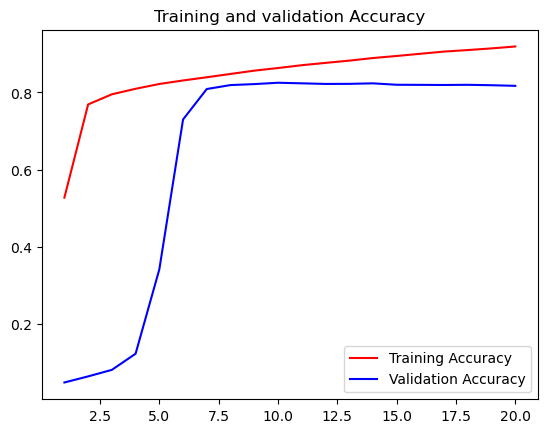

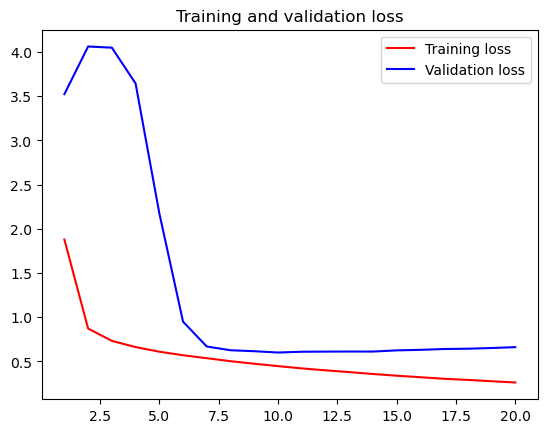

In [15]:
# Plot loss and accuracy
accuracy = history.history["accuracy"]
val_accuracy = history.history["val_accuracy"]
loss = history.history["loss"]
val_loss = history.history["val_loss"]
epochs = range(1, len(accuracy) + 1)
plt.plot(epochs, accuracy, "r", label="Training Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validation Accuracy")
plt.title("Training and validation Accuracy")
plt.legend()
plt.figure()
plt.plot(epochs, loss, "r", label="Training loss")
plt.plot(epochs, val_loss, "b", label="Validation loss")
plt.title("Training and validation loss")
plt.legend()
plt.show()

In [16]:
model.save("cnn_bach_model", save_format="tf")
model.evaluate(test_set)

34/34 [==============================] - 0s 12ms/step - loss: 0.6681 - accuracy: 0.8154


[0.6681405305862427, 0.8154131174087524]

Now let's write a function that will generate a new chorale. We will give it a few seed chords, it will convert them to arpegios (the format expected by the model), and use the model to predict the next note, then the next, and so on. In the end, it will group the notes 4 by 4 to create chords again, and return the resulting chorale.

In [17]:
def generate_chorale(model, seed_chords, length=32):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note = model.predict(arpegio, verbose=0).argmax(axis=-1)[:1, -1:]
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

## Primer:
To test this function, we need some seed chords. Let's use the first 8 chords of one of the test chorales (it's actually just 2 different chords, each played 4 times):

In [18]:
seed_chords = test_chorales[2][:8]
play_chords(seed_chords, amplitude=0.2)

## Generate Music

In [19]:
new_chorale = generate_chorale(model, seed_chords)
play_chords(new_chorale)

This approach has one major flaw: it is often too conservative. Indeed, the model will not take any risk, it will always choose the note with the highest score, and since repeating the previous note generally sounds good enough, it's the least risky option, so the algorithm will tend to make notes last longer and longer. Pretty boring. Plus, if you run the model multiple times, it will always generate the same melody.

So let's spice things up a bit! Instead of always picking the note with the highest score, we will pick the next note randomly, according to the predicted probabilities. For example, if the model predicts a C3 with 75% probability, and a G3 with a 25% probability, then we will pick one of these two notes randomly, with these probabilities. We will also add a `temperature` parameter that will control how "hot" (i.e., daring) we want the system to feel. A high temperature will bring the predicted probabilities closer together, reducing the probability of the likely notes and increasing the probability of the unlikely ones.

In [20]:
def generate_chorale_v2(model, seed_chords, length=32, temperature=1):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note_probas = model.predict(arpegio)[0, -1:]
            rescaled_logits = tf.math.log(next_note_probas) / temperature
            next_note = tf.random.categorical(rescaled_logits, num_samples=1)
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

Let's generate 3 chorales using this new function: one cold, one medium, and one hot (feel free to experiment with other seeds, lengths and temperatures). The code saves each chorale to a separate file. You can run these cells over an over again until you generate a masterpiece!

In [21]:
new_chorale_v2_cold = generate_chorale_v2(model, seed_chords, temperature=0.8)
play_chords(new_chorale_v2_cold, filepath="bach_cold.wav")

1/1 [==============================] - 0s 29ms/step


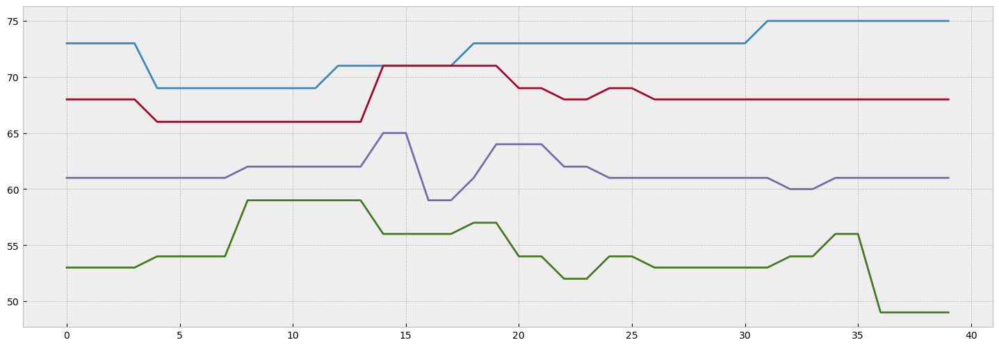

In [22]:
plt.figure(figsize=(18,6))
plt.style.use('bmh')
plt.plot(new_chorale_v2_cold)

plt.show()

In [23]:
new_chorale_v2_medium = generate_chorale_v2(model, seed_chords, temperature=1.0)
play_chords(new_chorale_v2_medium, filepath="bach_medium.wav")

1/1 [==============================] - 0s 21ms/step


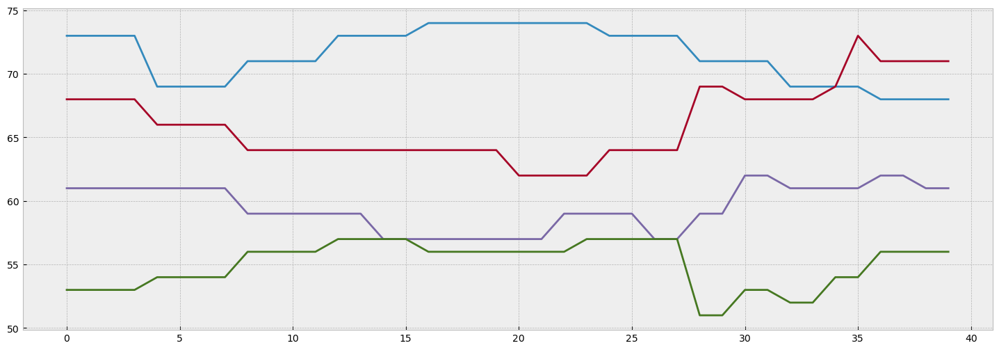

In [24]:
plt.figure(figsize=(18,6))
plt.style.use('bmh')
plt.plot(new_chorale_v2_medium)

plt.show()

In [25]:
new_chorale_v2_hot = generate_chorale_v2(model, seed_chords, temperature=1.5)
play_chords(new_chorale_v2_hot, filepath="bach_hot.wav")

1/1 [==============================] - 0s 22ms/step


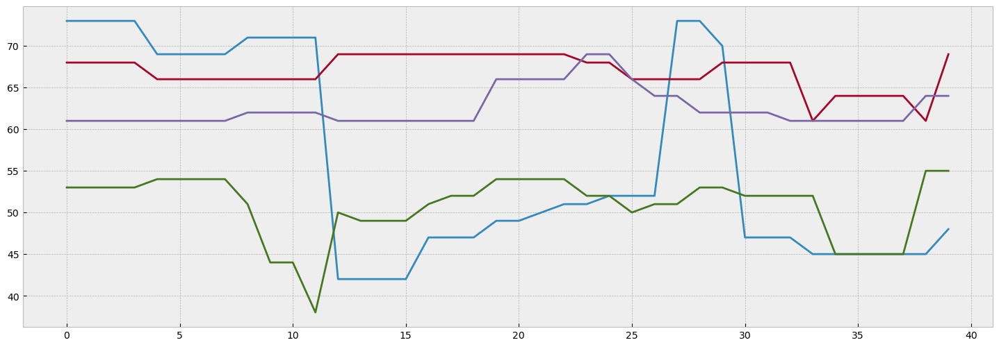

In [26]:
plt.figure(figsize=(18,6))
plt.style.use('bmh')
plt.plot(new_chorale_v2_hot)

plt.show()

So we can see that increasing the temperature increases variations in the generated notes. But that might not always sound pleasent.

# Transformer Model

We are going to use the text-generation notebook in chapter 12 of the book [Deep Learning with Python](https://www.amazon.ca/Deep-Learning-Python-Francois-Chollet/dp/1617294438) by Francois Chollet as a guiding resource. Though it was implemented for text generation, yet it is very suitable for the task of music generation. 

**Reference:** https://github.com/mahmudnahid/deep-learning-with-python-notebooks/blob/master/chapter12_part01_text-generation.ipynb

We’ll train a model to predict a probability distribution over the next note in a chorale, given a number of initial notes. When the model is trained, we’ll feed it with a prompt, sample the next note, add that note back to the prompt, and repeat, until we’ve generated a short chorale.

In [27]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow import keras

class PositionalEmbedding(layers.Layer):
    def __init__(self, sequence_length, input_dim, output_dim, **kwargs):
        super().__init__(**kwargs)
        self.token_embeddings = layers.Embedding(
            input_dim=input_dim, output_dim=output_dim)
        self.position_embeddings = layers.Embedding(
            input_dim=sequence_length, output_dim=output_dim)
        self.sequence_length = sequence_length
        self.input_dim = input_dim
        self.output_dim = output_dim

    def call(self, inputs):
        length = tf.shape(inputs)[-1]
        positions = tf.range(start=0, limit=length, delta=1)
        embedded_tokens = self.token_embeddings(inputs)
        embedded_positions = self.position_embeddings(positions)
        return embedded_tokens + embedded_positions

    def compute_mask(self, inputs, mask=None):
        return tf.math.not_equal(inputs, 0)

    def get_config(self):
        config = super(PositionalEmbedding, self).get_config()
        config.update({
            "output_dim": self.output_dim,
            "sequence_length": self.sequence_length,
            "input_dim": self.input_dim,
        })
        return config


In [28]:
class TransformerDecoder(layers.Layer):
    def __init__(self, embed_dim, dense_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.dense_dim = dense_dim
        self.num_heads = num_heads
        self.attention_1 = layers.MultiHeadAttention(
          num_heads=num_heads, key_dim=embed_dim)
        self.attention_2 = layers.MultiHeadAttention(
          num_heads=num_heads, key_dim=embed_dim)
        self.dense_proj = keras.Sequential(
            [layers.Dense(dense_dim, activation="relu"),
             layers.Dense(embed_dim),]
        )
        self.layernorm_1 = layers.LayerNormalization()
        self.layernorm_2 = layers.LayerNormalization()
        self.layernorm_3 = layers.LayerNormalization()
        self.supports_masking = True

    def get_config(self):
        config = super(TransformerDecoder, self).get_config()
        config.update({
            "embed_dim": self.embed_dim,
            "num_heads": self.num_heads,
            "dense_dim": self.dense_dim,
        })
        return config

    def get_causal_attention_mask(self, inputs):
        input_shape = tf.shape(inputs)
        batch_size, sequence_length = input_shape[0], input_shape[1]
        i = tf.range(sequence_length)[:, tf.newaxis]
        j = tf.range(sequence_length)
        mask = tf.cast(i >= j, dtype="int32")
        mask = tf.reshape(mask, (1, input_shape[1], input_shape[1]))
        mult = tf.concat(
            [tf.expand_dims(batch_size, -1),
             tf.constant([1, 1], dtype=tf.int32)], axis=0)
        return tf.tile(mask, mult)

    def call(self, inputs, encoder_outputs, mask=None):
        causal_mask = self.get_causal_attention_mask(inputs)
        if mask is not None:
            padding_mask = tf.cast(
                mask[:, tf.newaxis, :], dtype="int32")
            padding_mask = tf.minimum(padding_mask, causal_mask)
        else:
            padding_mask = mask
        attention_output_1 = self.attention_1(
            query=inputs,
            value=inputs,
            key=inputs,
            attention_mask=causal_mask)
        attention_output_1 = self.layernorm_1(inputs + attention_output_1)
        attention_output_2 = self.attention_2(
            query=attention_output_1,
            value=encoder_outputs,
            key=encoder_outputs,
            attention_mask=padding_mask,
        )
        attention_output_2 = self.layernorm_2(
            attention_output_1 + attention_output_2)
        proj_output = self.dense_proj(attention_output_2)
        return self.layernorm_3(attention_output_2 + proj_output)


In [29]:
embed_dim = 64
latent_dim = 1024
num_heads = 16
sequence_length = 128
vocab_size = 128

inputs = keras.Input(shape=(None,), dtype="int64")
x = PositionalEmbedding(sequence_length, vocab_size, embed_dim)(inputs)
x = TransformerDecoder(embed_dim, latent_dim, num_heads)(x, x)
x = layers.Dense(256, activation="relu")(x)
outputs = layers.Dense(n_notes, activation="softmax")(x) # Softmax over possible notes, computed for each output sequence.
model = keras.Model(inputs, outputs)

model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding (Position  (None, None, 64)    16384       ['input_1[0][0]']                
 alEmbedding)                                                                                     
                                                                                                  
 transformer_decoder (Transform  (None, None, 64)    663104      ['positional_embedding[0][0]',   
 erDecoder)                                                       'positional_embedding[0][0]']   
                                                                                              

In [30]:
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-3)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])
history = model.fit(train_set, epochs=20, validation_data=valid_set)

Epoch 1/20
98/98 [==============================] - 11s 53ms/step - loss: 2.2028 - accuracy: 0.3380 - val_loss: 1.7762 - val_accuracy: 0.4340
Epoch 2/20
98/98 [==============================] - 3s 34ms/step - loss: 1.6973 - accuracy: 0.4488 - val_loss: 1.6820 - val_accuracy: 0.4545
Epoch 3/20
98/98 [==============================] - 3s 35ms/step - loss: 1.5754 - accuracy: 0.4797 - val_loss: 1.4806 - val_accuracy: 0.5206
Epoch 4/20
98/98 [==============================] - 3s 35ms/step - loss: 1.1728 - accuracy: 0.6277 - val_loss: 0.9433 - val_accuracy: 0.7188
Epoch 5/20
98/98 [==============================] - 3s 33ms/step - loss: 0.8244 - accuracy: 0.7466 - val_loss: 0.7951 - val_accuracy: 0.7608
Epoch 6/20
98/98 [==============================] - 3s 34ms/step - loss: 0.7314 - accuracy: 0.7723 - val_loss: 0.7511 - val_accuracy: 0.7709
Epoch 7/20
98/98 [==============================] - 3s 32ms/step - loss: 0.6895 - accuracy: 0.7827 - val_loss: 0.7337 - val_accuracy: 0.7766
Epoch 8/20
9

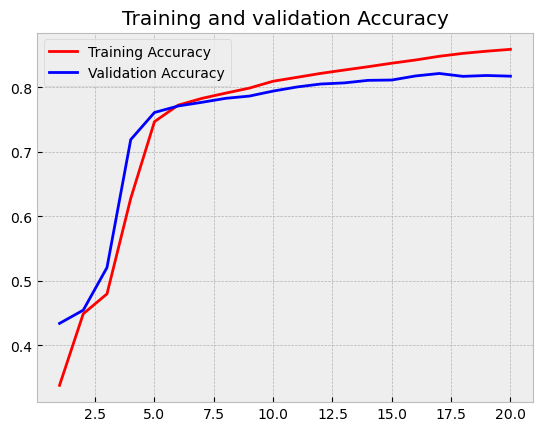

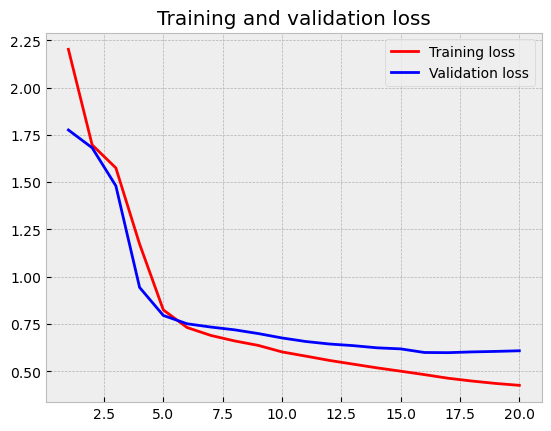

In [31]:
# Plot loss and accuracy
accuracy = history.history["accuracy"]
val_accuracy = history.history["val_accuracy"]
loss = history.history["loss"]
val_loss = history.history["val_loss"]
epochs = range(1, len(accuracy) + 1)
plt.plot(epochs, accuracy, "r", label="Training Accuracy")
plt.plot(epochs, val_accuracy, "b", label="Validation Accuracy")
plt.title("Training and validation Accuracy")
plt.legend()
plt.figure()
plt.plot(epochs, loss, "r", label="Training loss")
plt.plot(epochs, val_loss, "b", label="Validation loss")
plt.title("Training and validation loss")
plt.legend()
plt.show()

In [32]:
model.save("transformer_bach_model", save_format="tf")
model.evaluate(test_set)

34/34 [==============================] - 1s 15ms/step - loss: 0.6197 - accuracy: 0.8122


[0.6197395920753479, 0.8121928572654724]

## Primer

In [33]:
seed_chords = test_chorales[0][:8]
play_chords(seed_chords, amplitude=0.2)

## Generate Music

In [34]:
new_chorale_v2_cold = generate_chorale_v2(model, seed_chords, temperature=0.8)
play_chords(new_chorale_v2_cold, filepath="transformer_cold.wav")

1/1 [==============================] - 0s 21ms/step


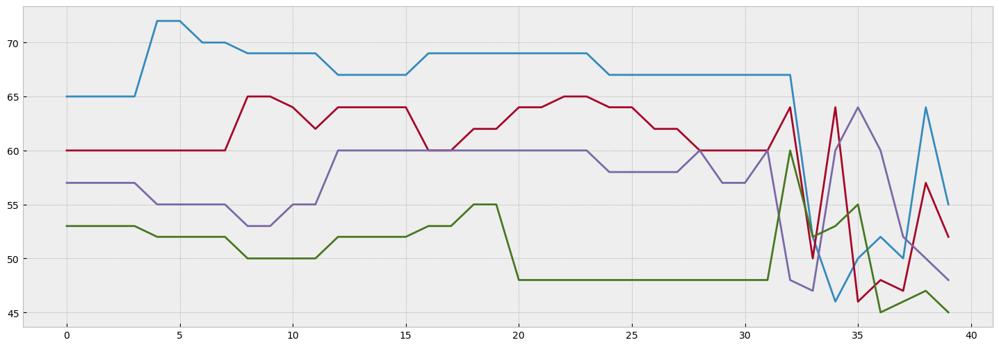

In [35]:
plt.figure(figsize=(18,6))
plt.style.use('bmh')
plt.plot(new_chorale_v2_cold)
plt.show()

In [36]:
new_chorale_v2_medium = generate_chorale_v2(model, seed_chords, temperature=1)
play_chords(new_chorale_v2_medium, filepath="transformer_medium.wav")

1/1 [==============================] - 0s 20ms/step


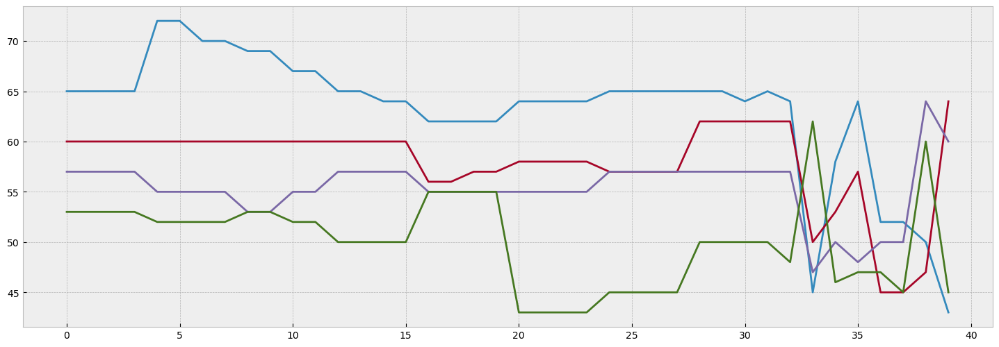

In [37]:
plt.figure(figsize=(18,6))
plt.style.use('bmh')
plt.plot(new_chorale_v2_medium)
plt.show()

In [38]:
new_chorale_v2_hot = generate_chorale_v2(model, seed_chords, temperature=1.5)
play_chords(new_chorale_v2_hot, filepath="transformer_hot.wav")

1/1 [==============================] - 0s 21ms/step


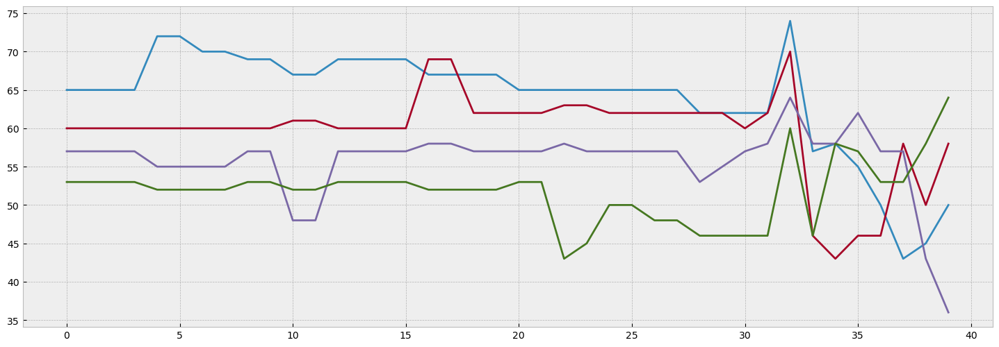

In [39]:
plt.figure(figsize=(18,6))
plt.style.use('bmh')
plt.plot(new_chorale_v2_hot)
plt.show()

# Conclusion
In our experiment CNN+LSTM model and Transformer Model achieved accuracy score 0.815 and 0.812 respectively. Though the accuracy score of both is in the same range yet from the graphs we found that if the sequence is long then the Transformer model might loose long-term coherence. 

While the Transformer allows us to capture self-reference through attention, it relies on absolute timing signals and thus has a hard time keeping track of regularity that is based on relative distances, event orderings, and periodicity. This is shown in the following graphs:

<img src="https://raw.githubusercontent.com/mahmudnahid/dl2-project2/main/images/cnn_cold.JPG" width="500" />

Fig: Generated chorale by CNN+LSTM model 

<img src="https://raw.githubusercontent.com/mahmudnahid/dl2-project2/main/images/transformer_cold.JPG" width="500" />

Fig: Generated chorale by Transformer model 


To address this specific problem Cheng-Zhi Anna Huang et. al. proposed Relative Attention based transformers in the paper [Music Transformer](https://arxiv.org/abs/1809.04281). A good expalantion of this technique is found in the google magenta blog-[Music Transformer: Generating Music with Long-Term Structure](https://magenta.tensorflow.org/music-transformer). But this was not covered in our current project. We wish to explore this model in future.



# Reference
- Chapter 15, [Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 2nd Edition](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/) by Aurélien Géron
- Chapter 12, [Deep Learning with Python](https://www.amazon.ca/Deep-Learning-Python-Francois-Chollet/dp/1617294438) by Francois Chollet
- https://www.youtube.com/watch?v=hXrpV2ffJRU&ab_channel=JustinGuitar
- https://github.com/marcelraas/music-generator/blob/master/presentation/2-music-generation.ipynb
- https://magenta.tensorflow.org/music-transformer